# Практическое задание к курсу

### 1. Обучите нейронную сеть любой архитектуры, которой не было на курсе, либо нейронную сеть разобранной архитектуры, но на том датасете, которого не было на уроках. Сделайте анализ того, что вам помогло в улучшения работы нейронной сети

#### CIFAR10 DCGAN

https://machinelearningmastery.com/how-to-develop-a-generative-adversarial-network-for-a-cifar-10-small-object-photographs-from-scratch/

In [1]:
from numpy import zeros
from numpy import ones
from numpy.random import randn
from numpy.random import randint
from tensorflow.keras.datasets.cifar10 import load_data
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import Dropout
from matplotlib import pyplot

In [2]:
def define_discriminator(in_shape=(32, 32, 3)):
    model = Sequential()

    model.add(Conv2D(64, (3, 3), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Flatten())
    model.add(Dropout(0.4))
    model.add(Dense(1, activation='sigmoid'))

    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    
    return model

In [3]:
def define_generator(latent_dim):
    model = Sequential()
    # 4x4
    n_nodes = 256 * 4 * 4
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((4, 4, 256)))
    # 8x8
    model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # 16x16
    model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # 32x32
    model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(3, (3, 3), activation='tanh', padding='same'))
    return model

In [4]:
def define_gan(g_model, d_model):
    d_model.trainable = False
    model = Sequential()
    model.add(g_model)
    model.add(d_model)
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    
    return model

In [5]:
def load_real_samples():
    # load cifar10
    (trainX, _), (_, _) = load_data()
    X = trainX.astype('float32')
    X = (X - 127.5) / 127.5
    return X

In [6]:
def generate_real_samples(dataset, n_samples):
    ix = randint(0, dataset.shape[0], n_samples)
    X = dataset[ix]
    y = ones((n_samples, 1))
    return X, y

In [7]:
def generate_latent_points(latent_dim, n_samples):
    x_input = randn(latent_dim * n_samples)
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input

In [8]:
def generate_fake_samples(g_model, latent_dim, n_samples):
    x_input = generate_latent_points(latent_dim, n_samples)
    X = g_model.predict(x_input)
    y = zeros((n_samples, 1))
    return X, y

In [9]:
def save_plot(examples, epoch, n=7):
    examples = (examples + 1) / 2.0
    for i in range(n * n):
        pyplot.subplot(n, n, 1 + i)
        pyplot.axis('off')
        pyplot.imshow(examples[i])

    pyplot.show()

In [10]:
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=150):
    X_real, y_real = generate_real_samples(dataset, n_samples)
    _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    print('>Accuracy real: %.0f%%, fake: %.0f%%' % (acc_real * 100, acc_fake * 100))
    save_plot(x_fake, epoch)
    filename = 'generator_model.h5'
    g_model.save(filename)

In [21]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=200, n_batch=128):
    bat_per_epo = int(dataset.shape[0] / n_batch)
    half_batch = int(n_batch / 2)

    for i in range(n_epochs):

        for j in range(bat_per_epo):
            X_real, y_real = generate_real_samples(dataset, half_batch)
            d_loss1, _ = d_model.train_on_batch(X_real, y_real)
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)
            X_gan = generate_latent_points(latent_dim, n_batch)
            y_gan = ones((n_batch, 1))
            g_loss = gan_model.train_on_batch(X_gan, y_gan)

            if j % 100 == 0:
                print('>%d, %d/%d, d1=%.3f, d2=%.3f g=%.3f' % (i + 1, j + 1, bat_per_epo, d_loss1, d_loss2, g_loss)) 
                
                summarize_performance(i, g_model, d_model, dataset, latent_dim)

In [12]:
latent_dim = 100

In [13]:
d_model = define_discriminator()

C:\Users\User\anaconda3\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [14]:
g_model = define_generator(latent_dim)

In [15]:
gan_model = define_gan(g_model, d_model)

In [16]:
# Загрузка данных
dataset = load_real_samples()

In [19]:
# Проверка GPU
import tensorflow as tf
import time

def time_matmul(x):
  start = time.time()
  for loop in range(10):
    tf.matmul(x, x)

  result = time.time()-start

  print("10 циклов: {:0.2f}ms".format(1000*result))

# исполнение CPU
print(" CPU работает:")
with tf.device("CPU:0"):
  x = tf.random.uniform([1000, 1000])
  assert x.device.endswith("CPU:0")
  time_matmul(x)

# исполнение на GPU #0 , если доступен
if tf.config.experimental.list_physical_devices("GPU"):
  print(" какой GPU:")
  with tf.device("GPU:0"): # или GPU:1 , для 2х GPU, GPU:2 для 3х  и т.д.
    x = tf.random.uniform([1000, 1000])
    assert x.device.endswith("GPU:0")
    time_matmul(x)

 CPU работает:
10 циклов: 39.89ms
 какой GPU:
10 циклов: 2.01ms


4/4 [==============================] - 0s 3ms/step
>1, 1/195, d1=0.164, d2=0.554 g=1.122
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 100%, fake: 100%


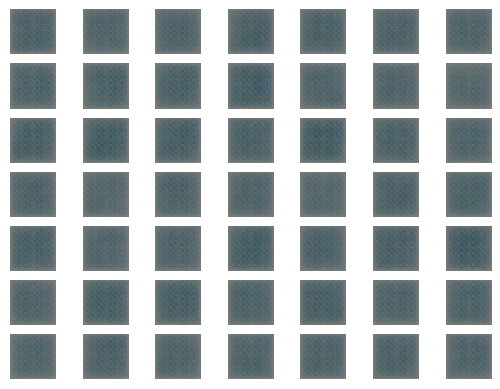

4/4 [==============================] - 0s 2ms/step
>1, 101/195, d1=0.400, d2=1.322 g=1.271
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 80%, fake: 36%


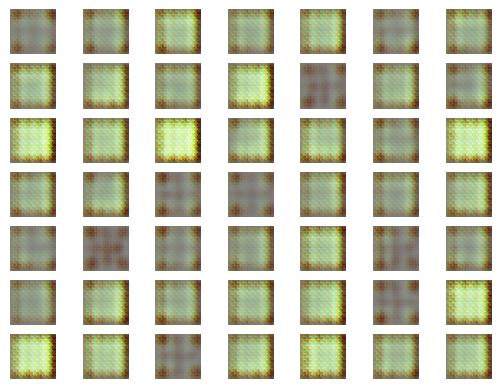

4/4 [==============================] - 0s 3ms/step
>2, 1/195, d1=0.260, d2=0.745 g=2.443
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 78%, fake: 72%


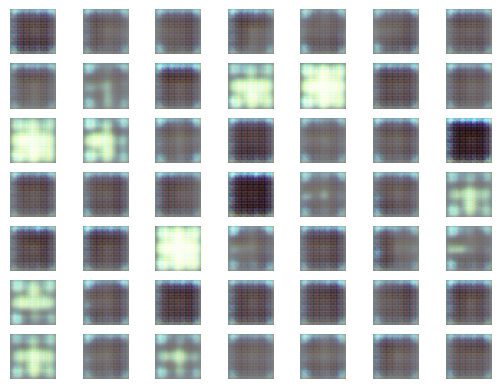

4/4 [==============================] - 0s 3ms/step
>2, 101/195, d1=0.758, d2=0.484 g=1.748
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 69%, fake: 100%


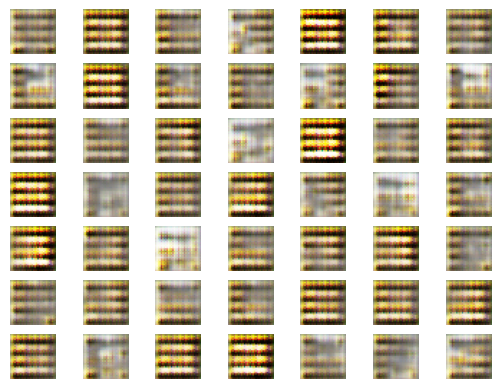

4/4 [==============================] - 0s 3ms/step
>3, 1/195, d1=0.517, d2=0.481 g=2.171
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 68%, fake: 93%


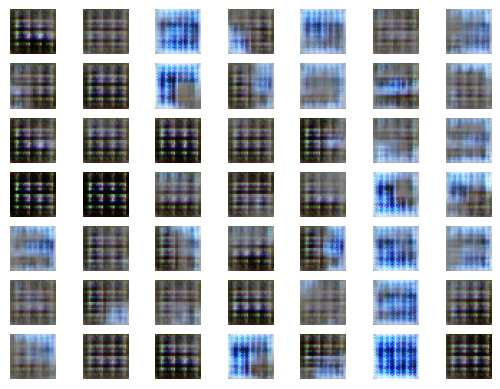

4/4 [==============================] - 0s 3ms/step
>3, 101/195, d1=0.552, d2=0.651 g=1.097
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 73%, fake: 71%


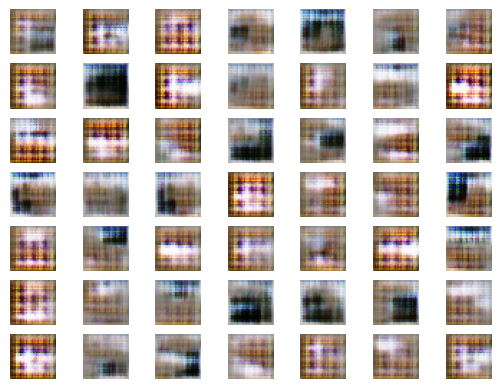

4/4 [==============================] - 0s 3ms/step
>4, 1/195, d1=0.534, d2=0.514 g=1.108
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 74%, fake: 91%


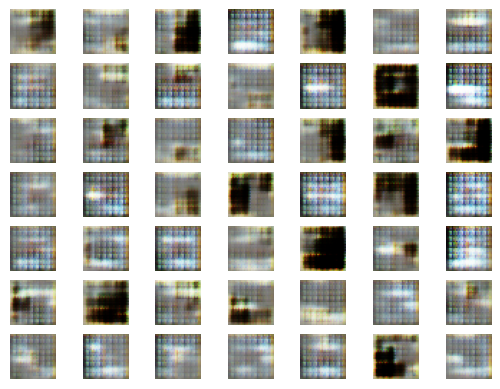

4/4 [==============================] - 0s 3ms/step
>4, 101/195, d1=0.929, d2=0.515 g=1.379
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 39%, fake: 81%


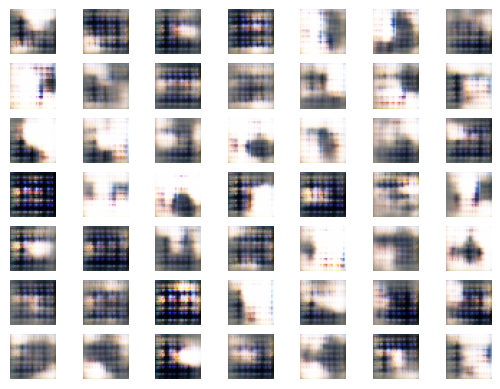

4/4 [==============================] - 0s 2ms/step
>5, 1/195, d1=0.687, d2=0.576 g=1.278
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 56%, fake: 81%


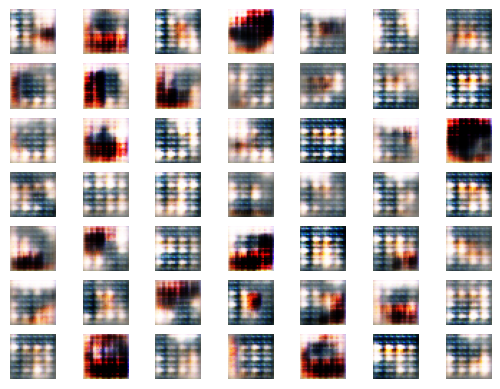

4/4 [==============================] - 0s 3ms/step
>5, 101/195, d1=0.640, d2=0.577 g=1.210
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 68%, fake: 75%


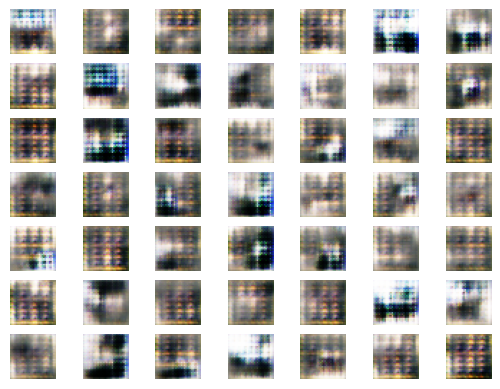

4/4 [==============================] - 3s 3ms/step
>6, 1/195, d1=0.558, d2=0.480 g=1.264
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 75%, fake: 97%


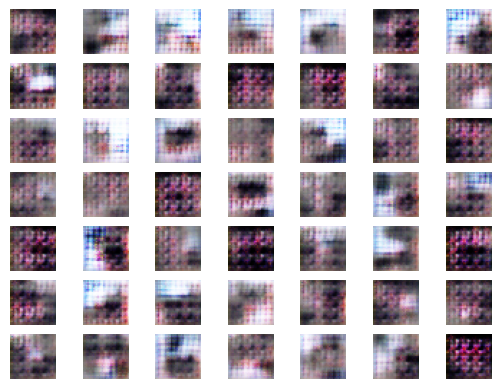

4/4 [==============================] - 0s 3ms/step
>6, 101/195, d1=0.656, d2=0.583 g=1.146
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 61%, fake: 91%


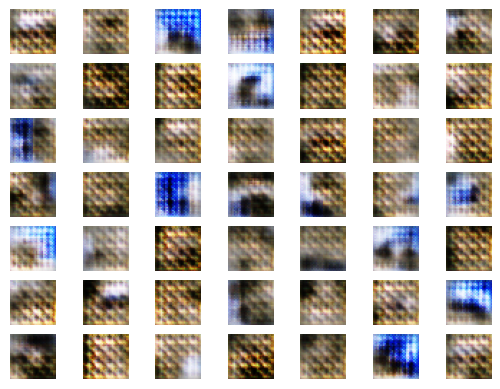

4/4 [==============================] - 0s 3ms/step
>7, 1/195, d1=0.589, d2=0.661 g=0.939
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 78%, fake: 69%


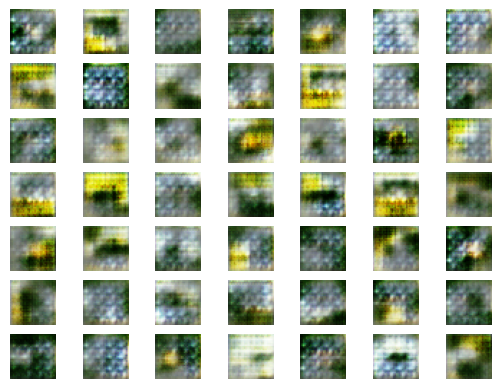

4/4 [==============================] - 0s 3ms/step
>7, 101/195, d1=0.590, d2=0.559 g=1.138
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 66%, fake: 77%


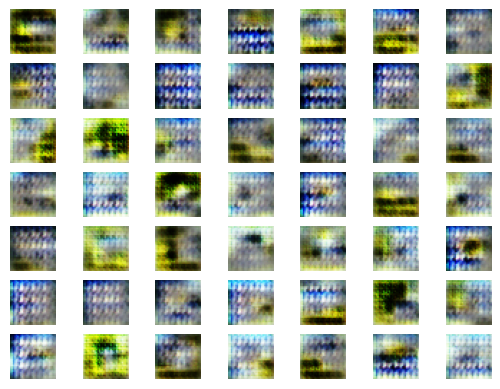

4/4 [==============================] - 0s 3ms/step
>8, 1/195, d1=0.559, d2=0.643 g=1.060
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 73%, fake: 69%


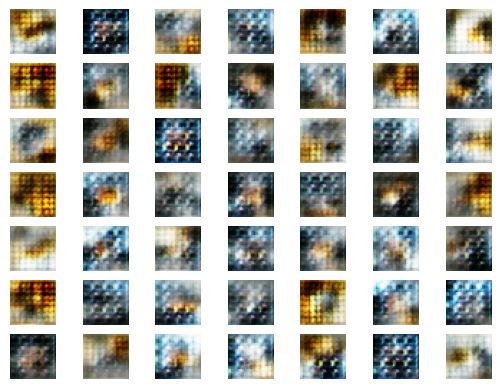

4/4 [==============================] - 0s 2ms/step
>8, 101/195, d1=0.575, d2=0.610 g=1.341
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 53%, fake: 81%


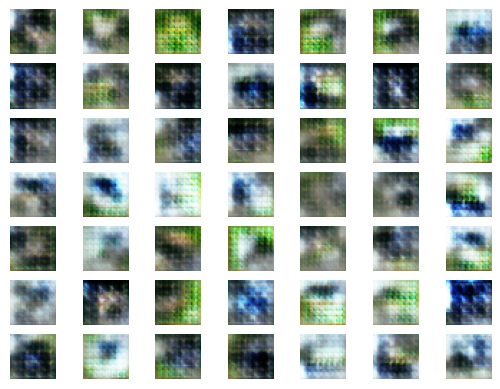

4/4 [==============================] - 3s 899ms/step
>9, 1/195, d1=0.559, d2=0.645 g=1.214
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 49%, fake: 83%


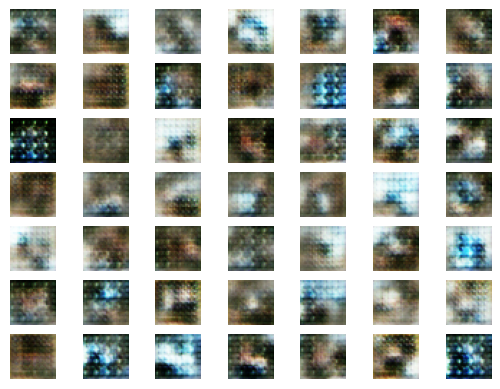

4/4 [==============================] - 0s 2ms/step
>9, 101/195, d1=0.629, d2=0.543 g=1.172
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 74%, fake: 90%


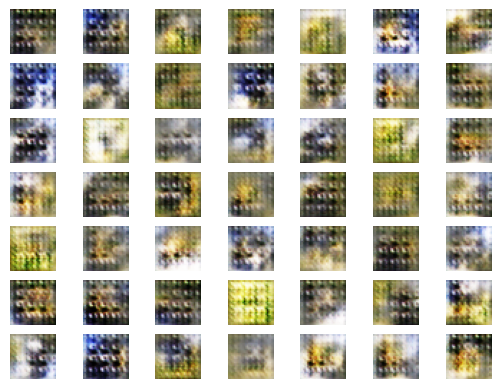

4/4 [==============================] - 0s 3ms/step
>10, 1/195, d1=0.632, d2=0.538 g=1.192
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 72%, fake: 87%


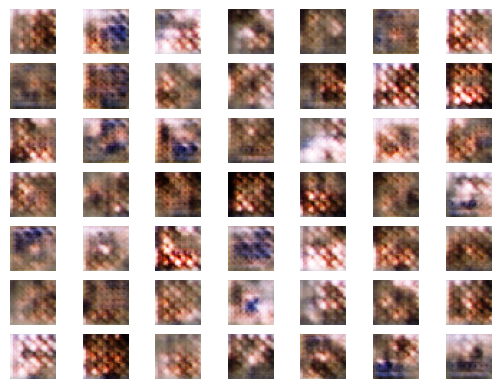

4/4 [==============================] - 0s 3ms/step
>10, 101/195, d1=0.504, d2=0.461 g=1.670
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 68%, fake: 93%


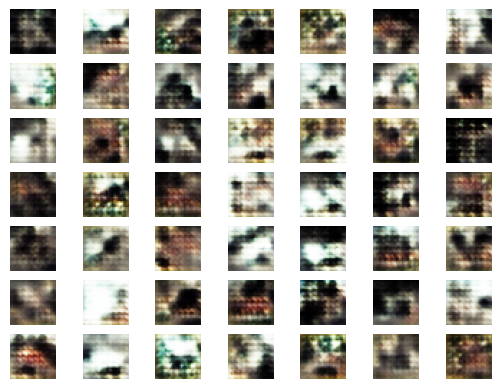

4/4 [==============================] - 0s 3ms/step
>11, 1/195, d1=0.587, d2=0.647 g=1.146
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 60%, fake: 82%


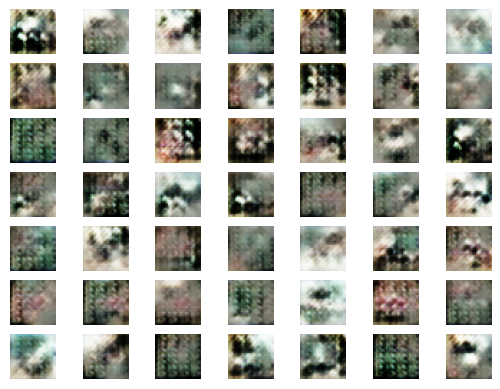

4/4 [==============================] - 0s 3ms/step
>11, 101/195, d1=0.629, d2=0.684 g=1.015
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 61%, fake: 71%


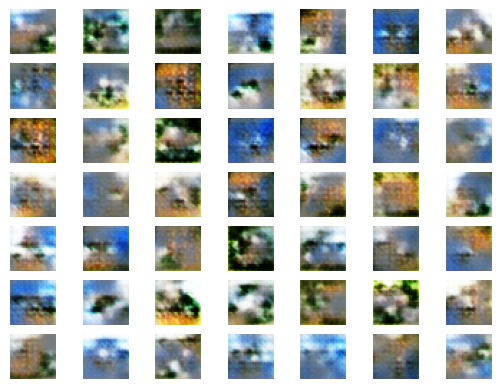

4/4 [==============================] - 0s 3ms/step
>12, 1/195, d1=0.640, d2=0.611 g=1.131
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 57%, fake: 73%


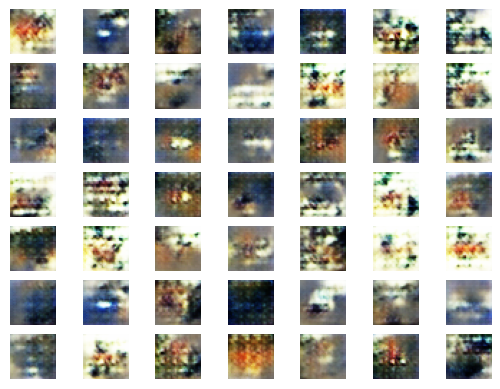

4/4 [==============================] - 0s 3ms/step
>12, 101/195, d1=0.589, d2=0.683 g=1.062
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 60%, fake: 76%


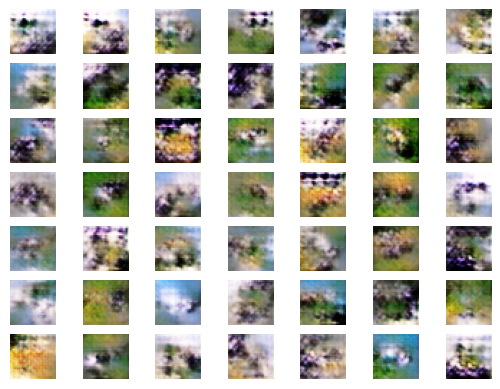

4/4 [==============================] - 0s 3ms/step
>13, 1/195, d1=0.561, d2=0.547 g=1.130
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 73%, fake: 80%


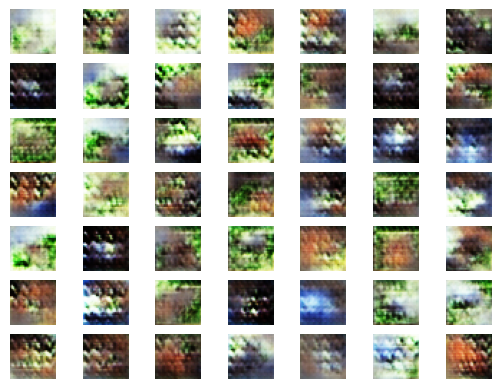

4/4 [==============================] - 0s 3ms/step
>13, 101/195, d1=0.699, d2=0.551 g=1.086
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 64%, fake: 92%


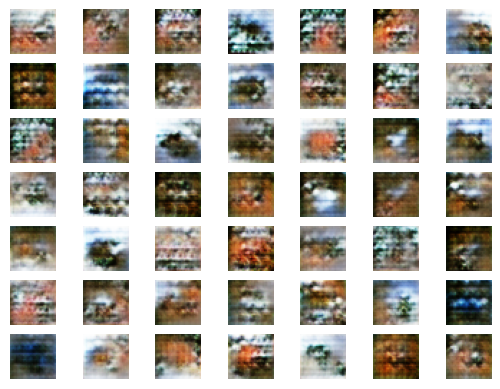

4/4 [==============================] - 0s 3ms/step
>14, 1/195, d1=0.775, d2=0.547 g=1.121
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 48%, fake: 95%


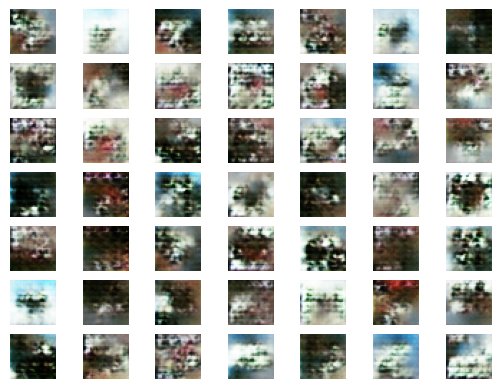

4/4 [==============================] - 0s 2ms/step
>14, 101/195, d1=0.618, d2=0.686 g=0.930
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 62%, fake: 67%


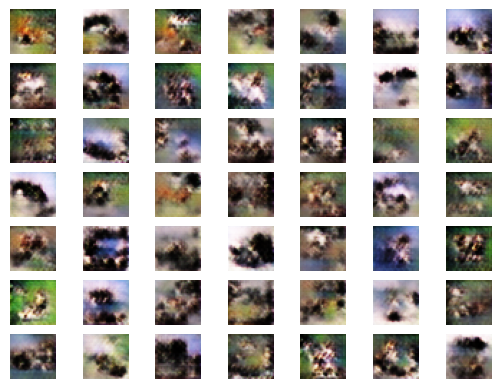

4/4 [==============================] - 0s 3ms/step
>15, 1/195, d1=0.649, d2=0.638 g=0.973
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 46%, fake: 77%


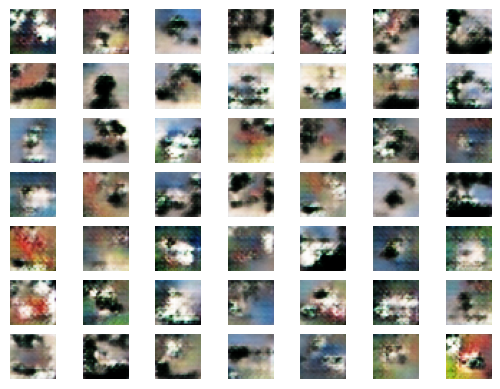

4/4 [==============================] - 0s 3ms/step
>15, 101/195, d1=0.675, d2=0.634 g=0.980
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 57%, fake: 85%


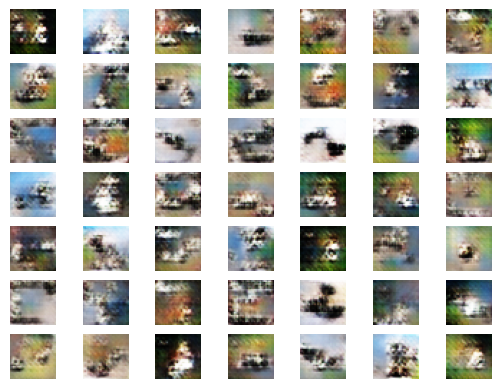

4/4 [==============================] - 0s 3ms/step
>16, 1/195, d1=0.712, d2=0.643 g=0.974
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 39%, fake: 77%


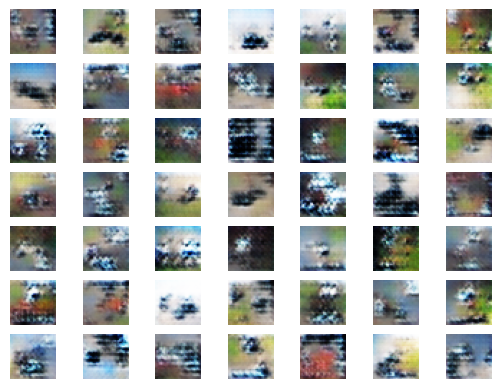

4/4 [==============================] - 0s 3ms/step
>16, 101/195, d1=0.641, d2=0.544 g=1.014
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 67%, fake: 81%


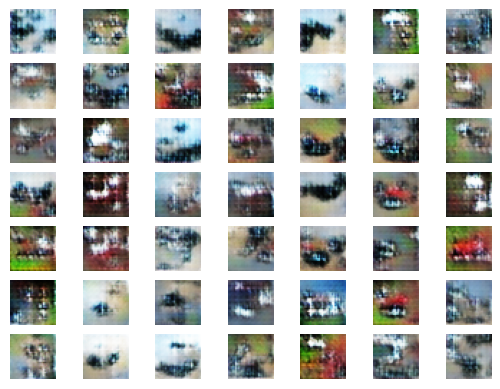

4/4 [==============================] - 0s 2ms/step
>17, 1/195, d1=0.721, d2=0.616 g=0.904
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 53%, fake: 81%


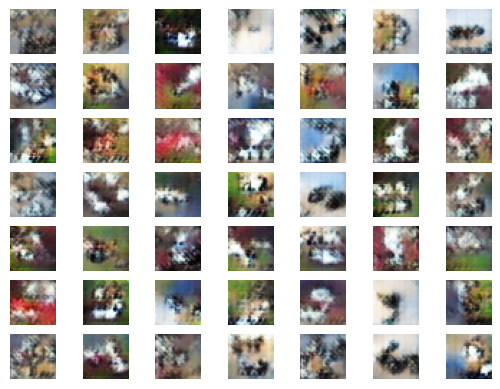

4/4 [==============================] - 0s 2ms/step
>17, 101/195, d1=0.601, d2=0.633 g=0.968
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 49%, fake: 83%


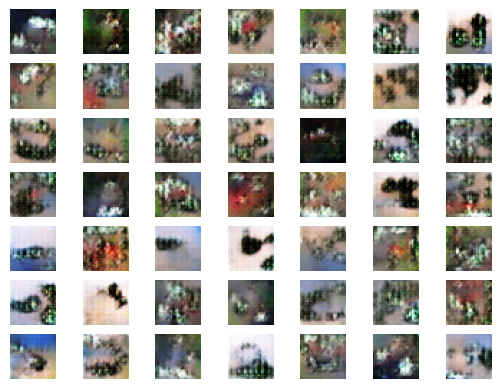

4/4 [==============================] - 0s 2ms/step
>18, 1/195, d1=0.681, d2=0.534 g=1.056
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 39%, fake: 97%


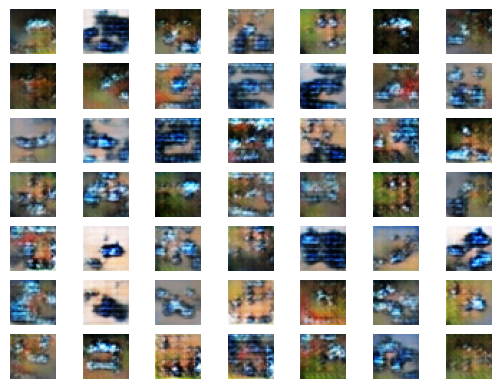

4/4 [==============================] - 0s 3ms/step
>18, 101/195, d1=0.707, d2=0.578 g=0.941
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 60%, fake: 89%


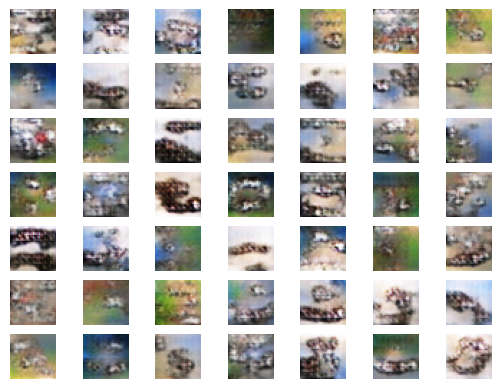

4/4 [==============================] - 0s 2ms/step
>19, 1/195, d1=0.750, d2=0.545 g=1.007
5/5 [==============================] - 3s 3ms/step
>Accuracy real: 38%, fake: 88%


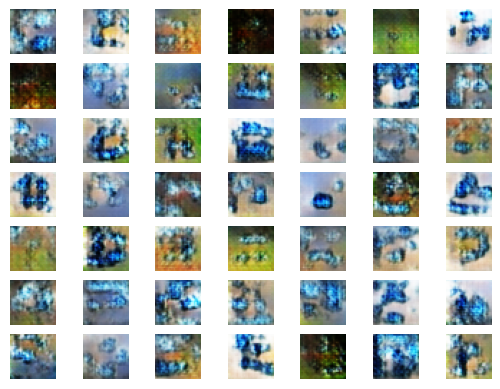

4/4 [==============================] - 0s 3ms/step
>19, 101/195, d1=0.744, d2=0.538 g=1.050
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 46%, fake: 91%


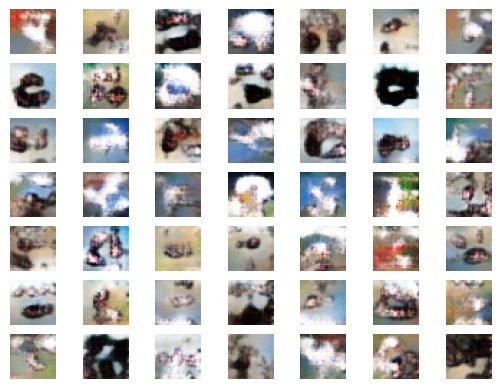

4/4 [==============================] - 0s 3ms/step
>20, 1/195, d1=0.682, d2=0.558 g=0.962
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 51%, fake: 89%


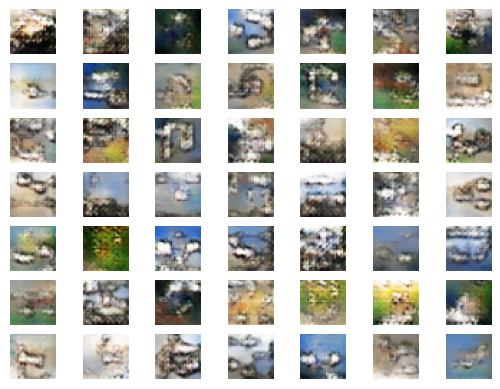

4/4 [==============================] - 0s 3ms/step
>20, 101/195, d1=0.709, d2=0.656 g=0.848
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 47%, fake: 76%


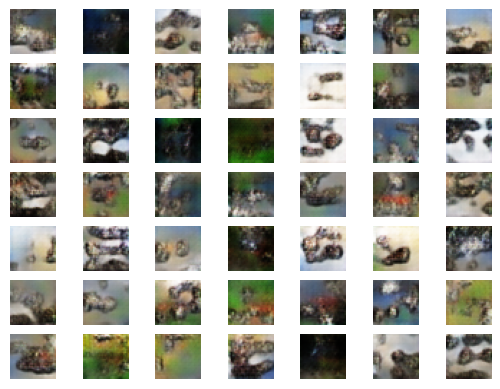

4/4 [==============================] - 0s 3ms/step
>21, 1/195, d1=0.621, d2=0.756 g=0.779
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 62%, fake: 45%


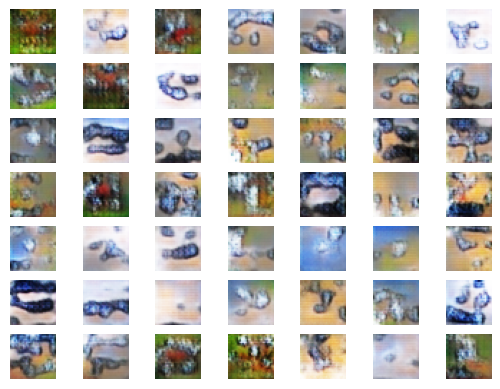

4/4 [==============================] - 3s 3ms/step
>21, 101/195, d1=0.642, d2=0.675 g=0.805
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 49%, fake: 69%


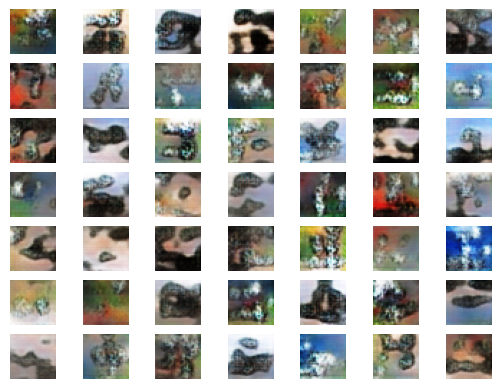

4/4 [==============================] - 0s 2ms/step
>22, 1/195, d1=0.710, d2=0.632 g=0.891
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 43%, fake: 83%


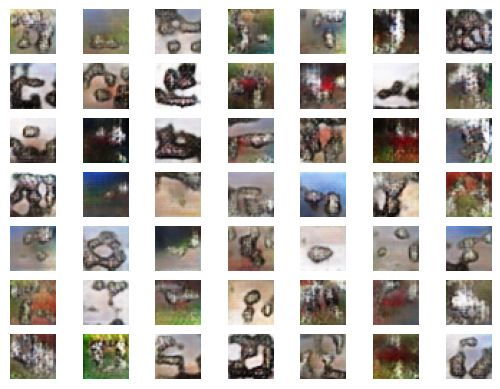

4/4 [==============================] - 0s 3ms/step
>22, 101/195, d1=0.718, d2=0.613 g=0.840
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 39%, fake: 77%


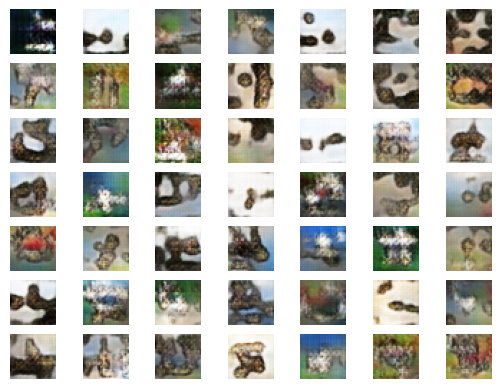

4/4 [==============================] - 0s 2ms/step
>23, 1/195, d1=0.608, d2=0.645 g=0.813
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 56%, fake: 86%


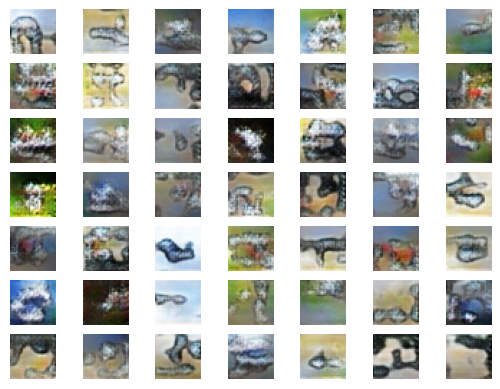

4/4 [==============================] - 0s 3ms/step
>23, 101/195, d1=0.657, d2=0.744 g=0.778
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 48%, fake: 74%


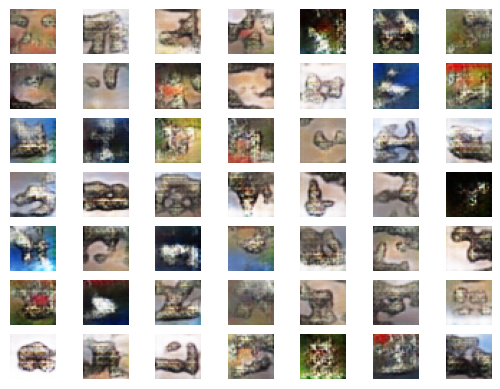

4/4 [==============================] - 0s 3ms/step
>24, 1/195, d1=0.673, d2=0.654 g=0.832
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 45%, fake: 83%


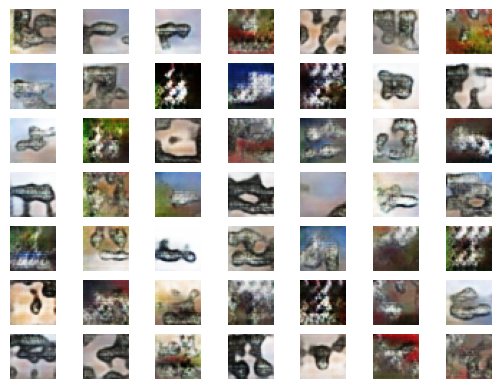

4/4 [==============================] - 0s 3ms/step
>24, 101/195, d1=0.677, d2=0.646 g=0.911
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 45%, fake: 86%


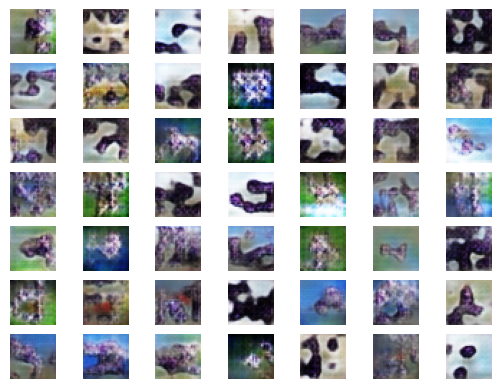

4/4 [==============================] - 0s 2ms/step
>25, 1/195, d1=0.683, d2=0.596 g=0.882
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 46%, fake: 87%


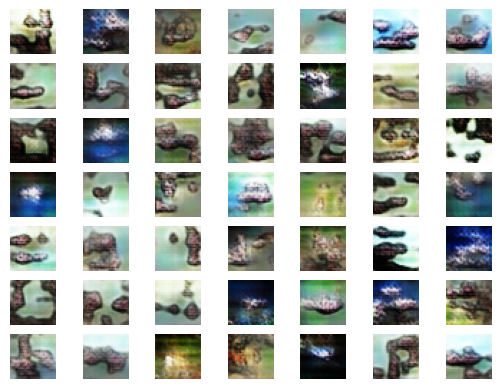

4/4 [==============================] - 3s 3ms/step
>25, 101/195, d1=0.710, d2=0.608 g=0.917
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 47%, fake: 81%


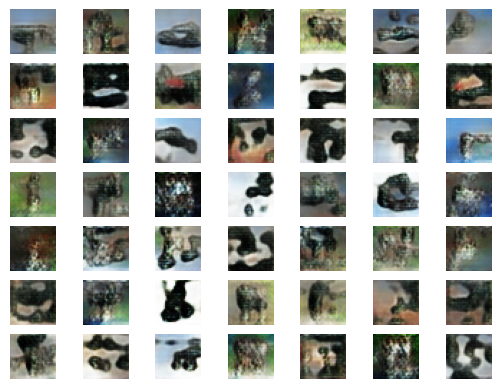

4/4 [==============================] - 0s 4ms/step
>26, 1/195, d1=0.675, d2=0.660 g=0.847
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 55%, fake: 80%


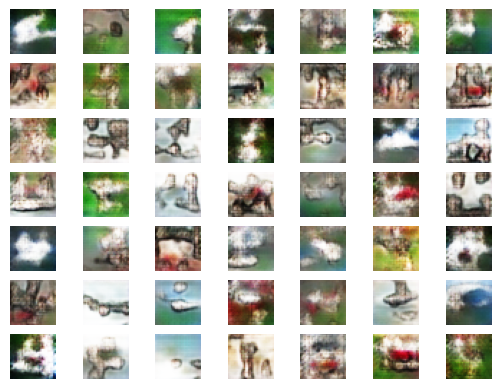

4/4 [==============================] - 0s 3ms/step
>26, 101/195, d1=0.587, d2=0.720 g=0.847
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 67%, fake: 68%


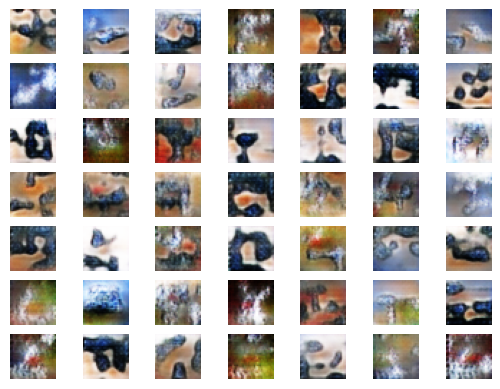

4/4 [==============================] - 0s 2ms/step
>27, 1/195, d1=0.706, d2=0.646 g=0.925
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 50%, fake: 81%


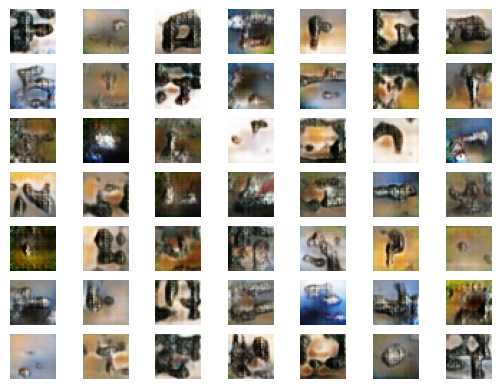

4/4 [==============================] - 0s 3ms/step
>27, 101/195, d1=0.700, d2=0.665 g=0.816
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 49%, fake: 67%


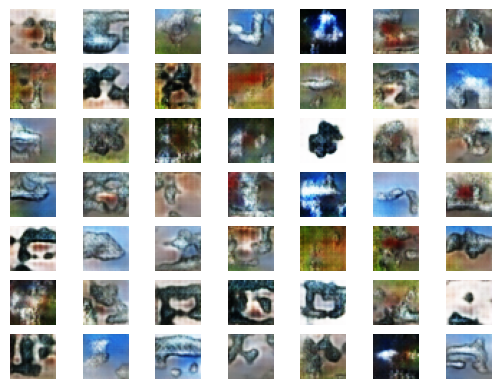

4/4 [==============================] - 0s 3ms/step
>28, 1/195, d1=0.780, d2=0.569 g=0.936
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 43%, fake: 89%


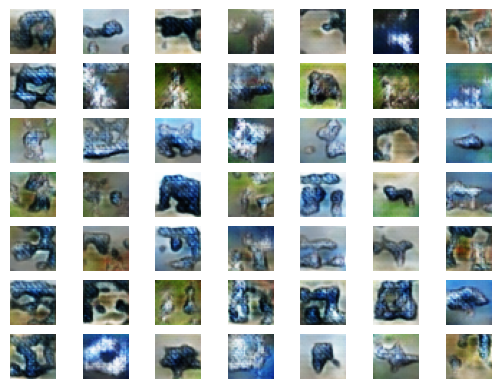

4/4 [==============================] - 0s 3ms/step
>28, 101/195, d1=0.684, d2=0.647 g=0.825
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 51%, fake: 79%


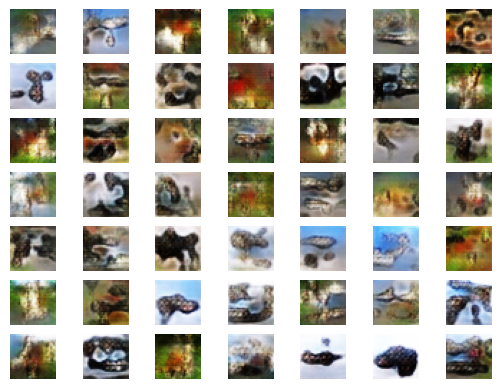

4/4 [==============================] - 0s 3ms/step
>29, 1/195, d1=0.706, d2=0.549 g=0.927
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 40%, fake: 87%


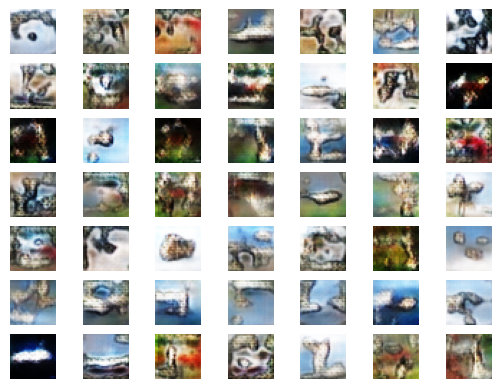

4/4 [==============================] - 0s 3ms/step
>29, 101/195, d1=0.678, d2=0.693 g=0.799
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 50%, fake: 58%


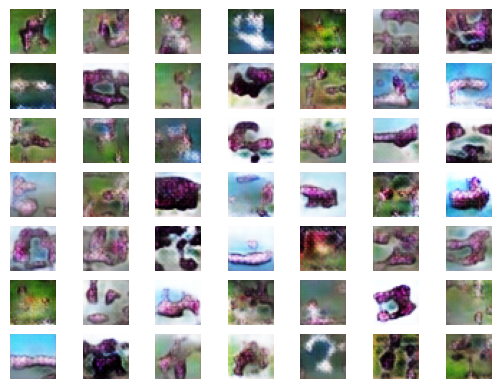

4/4 [==============================] - 0s 3ms/step
>30, 1/195, d1=0.690, d2=0.757 g=0.923
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 37%, fake: 72%


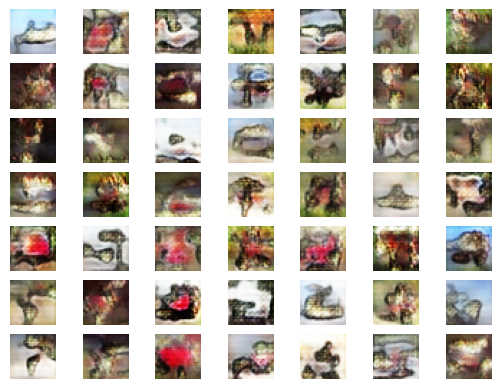

4/4 [==============================] - 0s 3ms/step
>30, 101/195, d1=0.687, d2=0.635 g=0.890
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 43%, fake: 79%


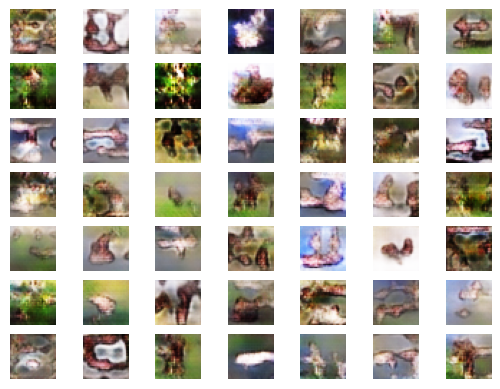

4/4 [==============================] - 0s 3ms/step
>31, 1/195, d1=0.636, d2=0.671 g=0.766
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 51%, fake: 69%


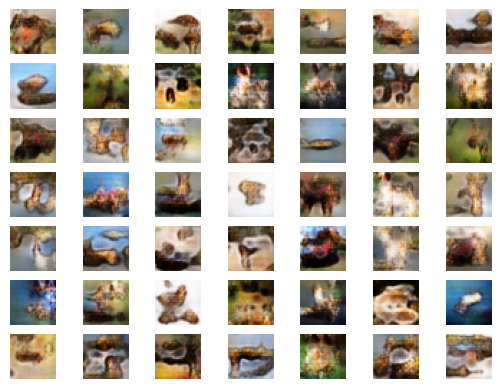

4/4 [==============================] - 0s 3ms/step
>31, 101/195, d1=0.644, d2=0.644 g=0.800
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 53%, fake: 69%


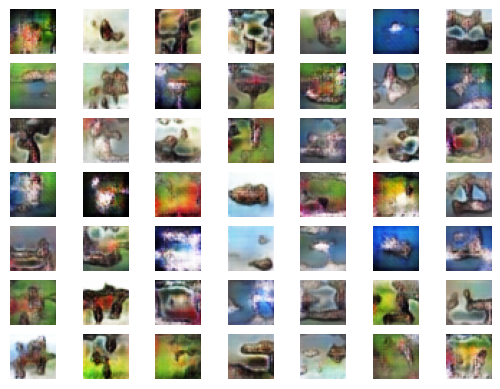

4/4 [==============================] - 0s 2ms/step
>32, 1/195, d1=0.641, d2=0.674 g=0.805
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 42%, fake: 81%


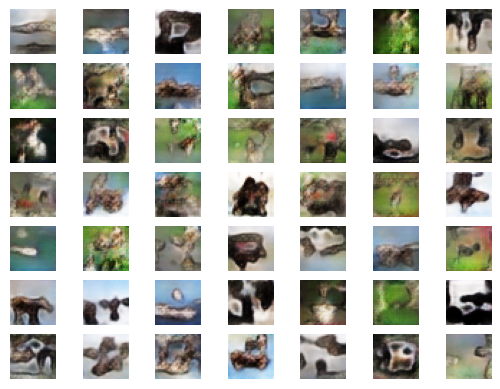

4/4 [==============================] - 0s 3ms/step
>32, 101/195, d1=0.720, d2=0.660 g=0.810
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 41%, fake: 75%


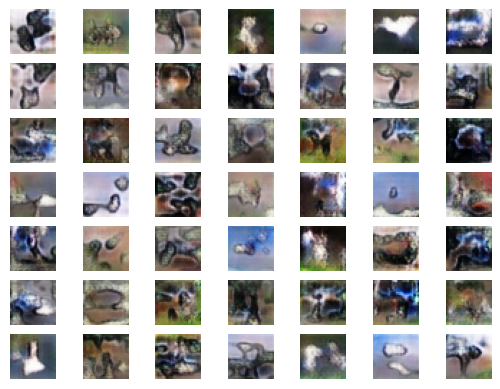

4/4 [==============================] - 0s 3ms/step
>33, 1/195, d1=0.673, d2=0.635 g=0.862
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 49%, fake: 83%


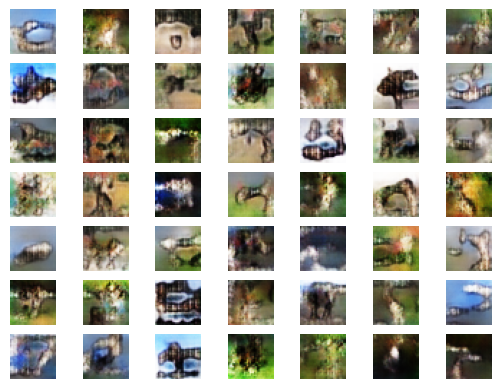

4/4 [==============================] - 0s 3ms/step
>33, 101/195, d1=0.715, d2=0.651 g=0.866
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 35%, fake: 86%


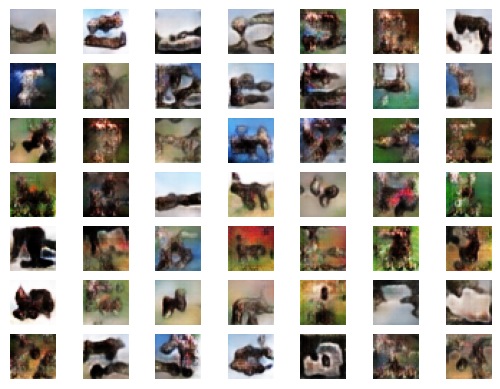

4/4 [==============================] - 0s 3ms/step
>34, 1/195, d1=0.694, d2=0.663 g=0.791
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 59%, fake: 69%


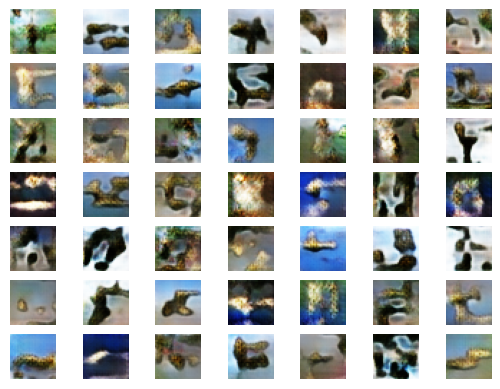

4/4 [==============================] - 0s 3ms/step
>34, 101/195, d1=0.670, d2=0.715 g=0.913
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 47%, fake: 83%


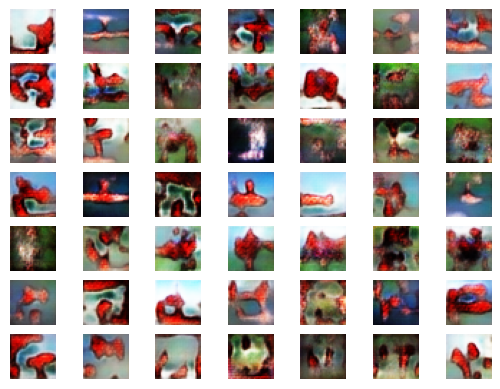

4/4 [==============================] - 0s 3ms/step
>35, 1/195, d1=0.729, d2=0.602 g=0.885
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 35%, fake: 80%


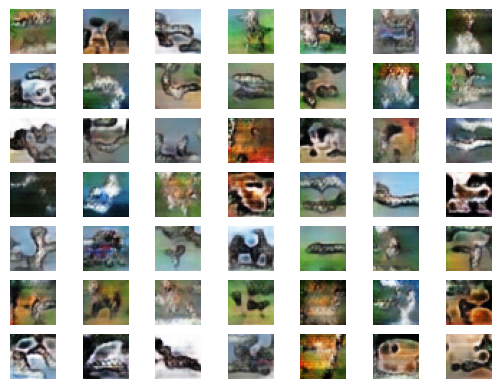

4/4 [==============================] - 0s 2ms/step
>35, 101/195, d1=0.672, d2=0.686 g=0.767
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 54%, fake: 65%


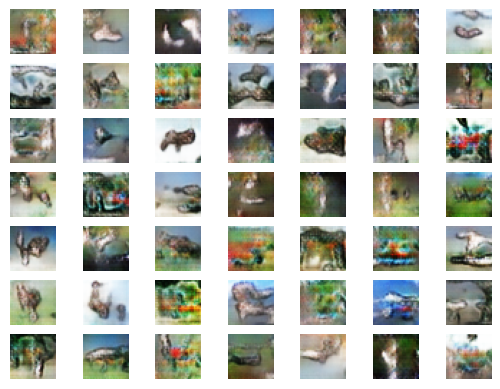

4/4 [==============================] - 0s 3ms/step
>36, 1/195, d1=0.669, d2=0.646 g=0.847
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 49%, fake: 81%


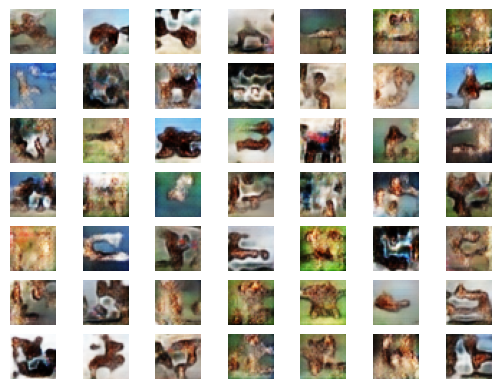

4/4 [==============================] - 0s 3ms/step
>36, 101/195, d1=0.698, d2=0.623 g=0.837
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 48%, fake: 81%


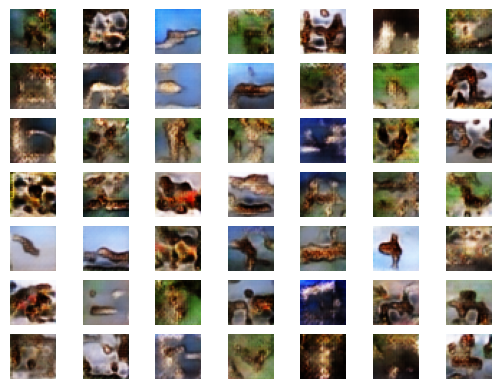

4/4 [==============================] - 0s 3ms/step
>37, 1/195, d1=0.599, d2=0.707 g=0.820
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 59%, fake: 65%


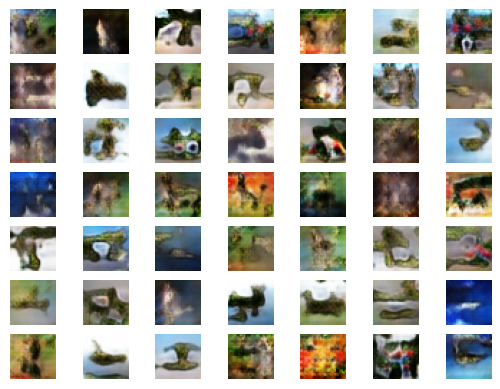

4/4 [==============================] - 0s 3ms/step
>37, 101/195, d1=0.680, d2=0.718 g=0.758
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 47%, fake: 69%


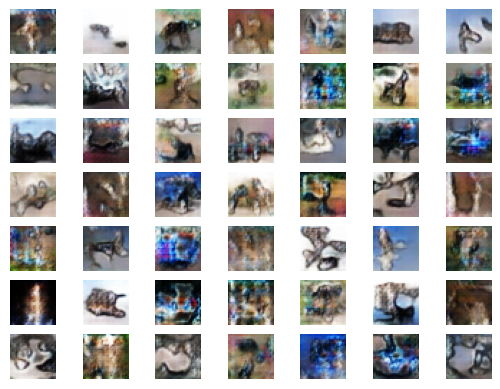

4/4 [==============================] - 0s 2ms/step
>38, 1/195, d1=0.701, d2=0.640 g=0.816
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 47%, fake: 84%


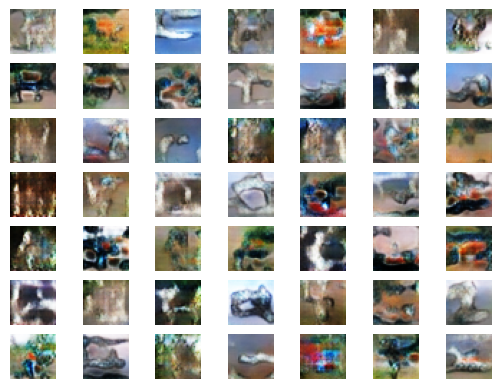

4/4 [==============================] - 0s 2ms/step
>38, 101/195, d1=0.678, d2=0.703 g=0.791
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 39%, fake: 83%


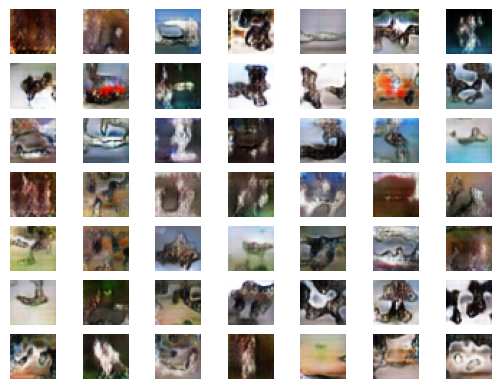

4/4 [==============================] - 3s 3ms/step
>39, 1/195, d1=0.660, d2=0.690 g=0.769
5/5 [==============================] - 0s 3ms/step
>Accuracy real: 56%, fake: 57%


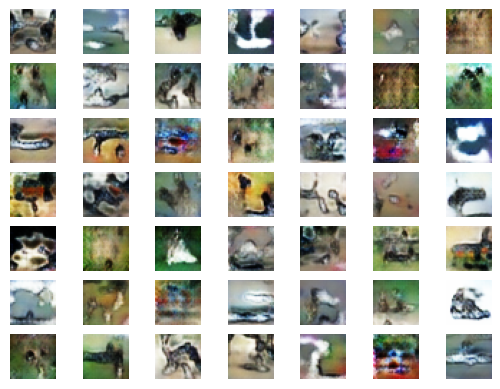

4/4 [==============================] - 0s 3ms/step
>39, 101/195, d1=0.697, d2=0.692 g=0.839
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 38%, fake: 80%


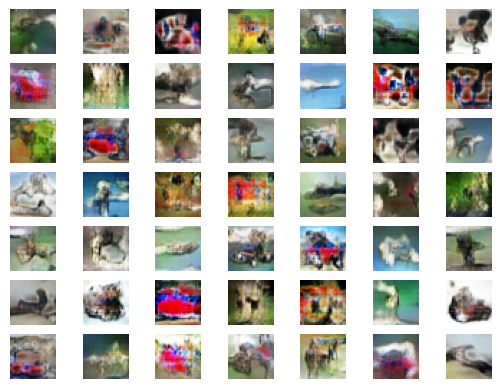

4/4 [==============================] - 0s 2ms/step
>40, 1/195, d1=0.662, d2=0.632 g=0.846
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 45%, fake: 89%


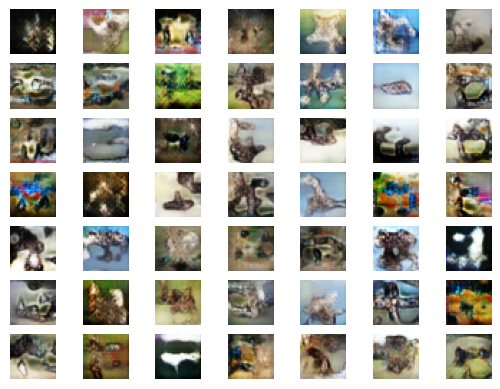

4/4 [==============================] - 0s 2ms/step
>40, 101/195, d1=0.638, d2=0.642 g=0.842
5/5 [==============================] - 0s 2ms/step
>Accuracy real: 64%, fake: 79%


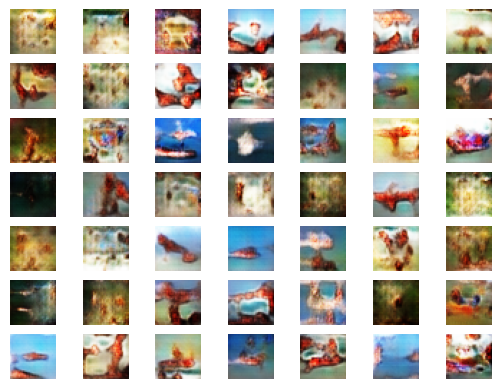

4/4 [==============================] - 0s 2ms/step


In [22]:
# Обучение
train(g_model, d_model, gan_model, dataset, latent_dim, 40, 256)

In [23]:
from tensorflow.keras.models import load_model

4/4 [==============================] - 0s 2ms/step


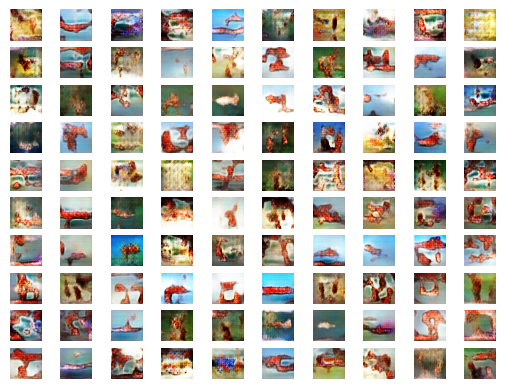

In [27]:
def generate_latent_points(latent_dim, n_samples):
    x_input = randn(latent_dim * n_samples)
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input

def create_plot(examples, n):
    # plot images
    for i in range(n * n):
        # define subplot
        pyplot.subplot(n, n, 1 + i)
        # turn off axis
        pyplot.axis('off')
        # plot raw pixel data
        pyplot.imshow(examples[i, :, :])
    pyplot.show()

model = load_model('generator_model.h5')

latent_points = generate_latent_points(100, 100)
X = model.predict(latent_points)
X = (X + 1) / 2.0

create_plot(X, 10)

### 2. Сделайте краткий обзор научной работы, посвящённой алгоритму нейронных сетей, не рассматриваемому ранее на курсе. Проведите анализ: чем отличается выбранная архитектура от других? В чём плюсы и минусы данной архитектуры? Какие могут возникнуть трудности при её применении на практике?

In [29]:
from IPython.display import Image
from IPython.core.display import HTML 

Обзор исследования: Capsule Networks – A survey, Journal of King Saud University - Computer and Information Sciences, Volume 34, Issue 1, January 2022, Pages 1295-1310, doi: 10.1016/j.jksuci.2019.09.014

Капсульные нейросети — это новое направление в области глубокого обучения, созданное для решения проблем сверточных нейросетей (CNN), связанных с требованием большого объема обучающих данных и сложностью распознавания деформированных объектов.
Капсульные сети были впервые предложены как альтернатива CNN в 2011 г. (Hinton et al.), а решение на CapsNets, показавшее отличные результаты на наборе данных MNIST было представлено в 2017, после чего наблюдается всплеск интереса к моделям глубокого обучения, использующих капсульные сети.<br><br>
Капсулы эквивариантны и состоят из сети нейронов, которые принимают и выводят векторы, а не скалярные значения CNN. Это свойство капсулы позволяет ей узнавать особенности изображения. В капсульной сети каждая капсула состоит из группы нейронов, причем выход каждого нейрона представляет собой различное свойство одной и той же функции. Это дает преимущество распознавания целого объекта путем распознавания его частей. Входные данные для капсулы — это выходные данные (или функции) CNN. Эти функции обрабатываются в зависимости от типа используемой капсулы. Параметры реализации используются для представления эквивариантности сети, указывающей на ее способность распознавать положение, текстуру и деформации. Инвариантность — это свойство модели оставаться неизменной независимо от любых преобразований входных данных. Например, если CNN обучена для распознавания лиц, то она будет обнаруживать лица даже если нос на изображении будет выше глаз. Однако эквивариантность обеспечивает учет пространственного расположения признаков на лице. В результате эквивариантность учитывает не только наличие глаза на изображении, но и его расположение на изображении. Эквивариантность является важным свойством CapsNets.
<br><br>
Первая капсульная сеть (2011) была опубликована под названием Transforming auto-encoders. Цель создания сети заключалась не в том, чтобы распознавать объекты на изображениях, а в том, чтобы принять изображение и его позу в качестве входных данных и вывести то же изображение в исходной позе.
<br><br>
Следующая модификация капсульных сетей (2017) определила капсулу как группу нейронов с параметрами реализации, представленными векторами активности, и длиной вектора, представляющей вероятность существования признака. Улучшение по сравнению с предыдущей реализацией заключалось в том, что в этом случае данные позы не требовались в качестве входных данных. Сеть состоит из сверточного уровня, уровня первичной капсулы (ПК) и уровня капсулы класса. Первичный капсульный слой — это первый капсульный слой, за которым следует неопределенное количество капсульных слоев до последнего капсульного слоя, также называемого капсульным слоем класса. Извлечение признаков из изображения выполняется с помощью сверточного слоя, а выходные данные подаются в первичный капсульный слой.
<br><br>
Базовая структура первой успешной капсульной сети была разработана Сабуром и Хинтоном (2017) и состояла из двух сверточных слоев. Conv1 имел 256 каналов, каждый из которых состоял из фильтров 9 × 9 с шагом 1 и функцией активации ReLU, примененной к изображению MNIST 28 × 28 × 1.
<br>
Второй слой был разработан как сверточный капсульный слой с 6 × 6 × 32 капсулами, каждая из которых выводит 8D-вектор. При шаге 2 каждая первичная капсула имеет 8 сверточных единиц, работающих с ядром 9×9. Нелинейность достигается путем применения функции сжатия (в качестве функции активации) для создания капсул 10, 16D. Этот слой также является основным капсульным слоем, получающим функции в качестве выходных данных масштабатора из слоя Conv1, после чего всем слоям придется иметь дело со значениями вектора 8D. Слой состоит из 32 каналов с сеткой первичных капсул 6×6 в каждом. Третий уровень (DigitCaps) представляет собой полностью связанный слой с десятью капсулами 16D, каждая из которых получает входные данные от всех капсул нижнего уровня для выполнения классификации на основе 10 классов. Последний слой определяет длину каждой капсулы в предыдущем слое, необходимую для получения вероятности присутствия сущности.

In [31]:
Image(url= "https://ars.els-cdn.com/content/image/1-s2.0-S1319157819309322-gr5_lrg.jpg")

Свойства набора данных имеют решающее значение для производительности алгоритма. Набор данных MNIST прост, имеет только один канал по сравнению с более сложными наборами данных, имеющими различные цвета, размер, шум, естественный фон сцены, аффинные преобразования, несколько цифр в одной выборке и т. д. Независимо от этих сложностей, CapsNet работает лучше, чем CNN на множестве более сложных наборов данных. В сложных наборах данных, таких как SVHN и CIFAR10, которые имеют высокие внутриклассовые вариации и фоновый шум, производительность CapsNet не соответствует современному уровню техники, но все же лучше, чем CNN (AlexNet). Однако для семейства наборов данных MNIST; MNIST и Fashion-MNIST, CapsNet может достичь современного уровня производительности, поскольку они менее сложны. Различные гиперпараметры, такие как скорость обучения, импульс, размер пакета, скорость отсева и снижение скорости обучения, не оказывают существенного влияния на производительность CapsNets. Однако соответствующие операции маршрутизации и количество итераций алгоритма динамической маршрутизацииделает, и это самый важный гиперпараметр, который значительно влияет на производительность CapsNets. 
<br><br>
CapsNets перспективны с точки зрения улучшения социально-экономической деятельности, поскольку их можно использовать для решения реальных жизненных задач в астрономии, автономных автомобилях, машинном переводе, распознавание рукописного текста и текста, обнаружение намерений, определение настроения и эмоций и так далее. Пространственно-временной характер данных о трафике, выраженных в изображениях, позволяет применять CapsNets для прогнозирования скорости движения и ненормального поведения водителей. Для задачи обработки естественного языка (NLP), такой как завершение графа знаний (KG) и сохранение параметров модели встраивания слов, CapsNets показали лучшую производительность чем CNN. CapsNets нашли применение в здравоохранении: извлечение семантических отношений между сущностями в медицинских картах с помощью рекуррентной сети CapsNet может эффективно использоваться в качестве основы для выявления проблем со здоровьем и степени их тяжести. Еще одна область применения CapsNets - это кассификация структуры семейства белков. Внимание CapsNet к иерархическим отношениям дает им преимущество перед CNN в графической или классификации структуры белка: процессе, необходимом для определения функции и помощи в разработке лекарств.
<br><br>
Несмотря на то, что показано, что капсулы превосходят CNN, есть области, в которых их работа не оптимальна. Например, отсутствие операции объединения означает, что капсула попытается учесть каждый аспект входного изображения, включая фоновый шум.
<br><br>
Капсула работает по-разному в разных наборах данных. Такие наборы данных, как CIFAR10 и ImageNet, по-прежнему остаются проблемой для CapsNets. Эти изображения и их виды могут быть данными, необходимыми в качестве входных данных для моделей, необходимых для выполнения критических задач.